<a href="https://colab.research.google.com/github/matilannes/projects/blob/main/CreditCardsAnalysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Trabajo Final - Caballero, Lannes, Andion**

Este es un trabajo de limpieza y exploracion de una base de datos de un banco, particularmente del sector de tarjetas de credito.

In [ ]:
import pandas as pd

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Trabajo final/BankChurners.csv')

#### **Carga y visualización del Dataset**

In [ ]:
df

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.999910
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.999940
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.999980
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.999870
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.999980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,...,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0.000191,0.999810
10123,710638233,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,...,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0.995270,0.004729
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,...,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0.997880,0.002118
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,...,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0.996710,0.003294


#### **Dimensiones del dataset**

In [ ]:
# Cantidad de clientes vs columnas a analizar

df.shape

(10127, 23)

#### **Información general del dataset**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 23 columns):
 #   Column                                                                                                                              Non-Null Count  Dtype  
---  ------                                                                                                                              --------------  -----  
 0   CLIENTNUM                                                                                                                           10127 non-null  int64  
 1   Attrition_Flag                                                                                                                      10127 non-null  object 
 2   Customer_Age                                                                                                                        10127 non-null  int64  
 3   Gender                                                                           

#### **Estadísticas descriptivas**

In [ ]:
df.describe()

,CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
count,1.012700e+04,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000
mean,7.391776e+08,46.325960,2.346203,35.928409,3.812580,2.341167,2.455317,8631.953698,1162.814061,7469.139637,0.759941,4404.086304,64.858695,0.712222,0.274894,0.159997,0.840003
std,3.690378e+07,8.016814,1.298908,7.986416,1.554408,1.010622,1.106225,9088.776650,814.987335,9090.685324,0.219207,3397.129254,23.472570,0.238086,0.275691,0.365301,0.365301
min,7.080821e+08,26.000000,0.000000,13.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,510.000000,10.000000,0.000000,0.000000,0.000008,0.000420
25%,7.130368e+08,41.000000,1.000000,31.000000,3.000000,2.000000,2.000000,2555.000000,359.000000,1324.500000,0.631000,2155.500000,45.000000,0.582000,0.023000,0.000099,0.999660
50%,7.179264e+08,46.000000,2.000000,36.000000,4.000000,2.000000,2.000000,4549.000000,1276.000000,3474.000000,0.736000,3899.000000,67.000000,0.702000,0.176000,0.000181,0.999820
75%,7.731435e+08,52.000000,3.000000,40.000000,5.000000,3.000000,3.000000,11067.500000,1784.000000,9859.000000,0.859000,4741.000000,81.000000,0.818000,0.503000,0.000337,0.999900
max,8.283431e+08,73.000000,5.000000,56.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,3.397000,18484.000000,139.000000,3.714000,0.999000,0.999580,0.999990


#### **Verificación de valores faltantes**

In [ ]:
# Remplazamos datos desconocidos ("Unknown") como nulos para poder identificarlos

df.replace('Unknown', None, inplace = True )

In [ ]:
nulos_por_columna = df.isna().sum()
nulos_por_columna

,0
CLIENTNUM,0
Attrition_Flag,0
Customer_Age,0
Gender,0
Dependent_count,0
Education_Level,1519
Marital_Status,749
Income_Category,1112
Card_Category,0
Months_on_book,0


#### **Duplicados**

In [ ]:
# Buscamos valores duplicados en la columna "Clientnum" para verificar que los registros sean unicos

df.duplicated('CLIENTNUM')

,0
0,False
1,False
2,False
3,False
4,False
...,...
10122,False
10123,False
10124,False
10125,False


In [ ]:
df.duplicated('CLIENTNUM').sum()

0

#### **Valores únicos y su cantidad**

In [ ]:
# Valores únicos: no es relevante para nuestro análisis

df['Income_Category'].unique()

array(['$60K - $80K', 'Less than $40K', '$80K - $120K', '$40K - $60K',
       '$120K +', None], dtype=object)

#### **Frecuencia de valores en columnas categóricas**

In [ ]:
# Cantidad de registros por ingresos

conteo_income_category = df['Income_Category'].value_counts()
conteo_income_category

,count
Income_Category,
Less than $40K,3561
$40K - $60K,1790
$80K - $120K,1535
$60K - $80K,1402
$120K +,727


In [ ]:
# Conteo de Clientes existentes vs Clientes inactivos

conteo_Attrition_Flag = df['Attrition_Flag'].value_counts()
conteo_Attrition_Flag

,count
Attrition_Flag,
Existing Customer,8500
Attrited Customer,1627


In [ ]:
# Cantidad de clientes según género

conteo_gender = df['Gender'].value_counts()
conteo_gender

,count
Gender,
F,5358
M,4769


In [ ]:
# Conteo de clientes por tipo de tarjeta

conteo_Card_category = df['Card_Category'].value_counts()
conteo_Card_category

,count
Card_Category,
Blue,9436
Silver,555
Gold,116
Platinum,20


#### **Quitamos últimas 2 columnas ya que no aplican a nuestro análisis**

In [ ]:
df.drop(['Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
         'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'],
        axis=1, inplace=True)

In [ ]:
df.shape

(10127, 21)

#### **Renombrar columnas**

In [ ]:
# Renombramos 2 columnas de nuestro dataset para clarificar su contenido

df_renombrado = df.rename(columns={'Total_Relationship_Count': 'Total_Products',
                                   'Avg_Open_To_Buy': 'Avg_Available_Credit'},
                                    inplace=True)

In [ ]:
pd.set_option('display.max_columns', None) # Muestra todas las columnas

In [ ]:
df

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Products,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Available_Credit,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,None,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,710638233,Attrited Customer,41,M,2,None,Divorced,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,717406983,Attrited Customer,30,M,2,Graduate,None,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


#### **Ordenar el dataset**

In [ ]:
# Ordenado por edad ascendente para visualizar comportamiento de ingresos y límites en funcion de dicha variable.

df_ordenado = df.sort_values(by='Customer_Age')
df_ordenado

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Products,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Available_Credit,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
910,809342208,Existing Customer,26,M,0,Graduate,Single,None,Blue,19,4,1,2,1438.3,0,1438.3,0.472,2005,47,0.469,0.000
1462,771556308,Existing Customer,26,F,0,High School,Single,Less than $40K,Blue,13,6,3,4,3517.0,1195,2322.0,0.556,2255,48,0.500,0.340
1592,714248733,Existing Customer,26,F,0,None,Single,None,Blue,13,4,1,2,4395.0,1240,3155.0,0.662,2272,46,0.438,0.282
5462,711336033,Existing Customer,26,F,0,None,Single,None,Blue,36,3,3,2,7595.0,1032,6563.0,1.035,4080,72,0.800,0.136
1908,710934033,Existing Customer,26,M,0,High School,Single,Less than $40K,Blue,13,6,1,4,1775.0,1162,613.0,0.930,2169,43,0.536,0.655
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177,717296808,Existing Customer,67,F,1,Graduate,Married,Less than $40K,Blue,56,4,3,2,3006.0,2517,489.0,2.053,1661,32,1.000,0.837
151,712720158,Existing Customer,68,M,1,Graduate,Married,None,Blue,56,5,2,3,13860.0,1652,12208.0,1.255,1910,32,1.909,0.119
198,708868233,Attrited Customer,68,M,0,High School,Married,Less than $40K,Blue,52,1,3,2,1438.3,900,538.3,0.743,760,21,0.615,0.626
254,787348608,Existing Customer,70,M,0,High School,Married,Less than $40K,Blue,56,3,2,3,3252.0,1495,1757.0,0.581,1227,15,0.875,0.460


#### **Filtrado de datos**

In [ ]:
# Filtrado de datos: nos quedamos solo con los clientes existentes

cust_activos = df[df['Attrition_Flag'] == 'Existing Customer']
cust_activos

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Products,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Available_Credit,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,None,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10116,714109308,Existing Customer,46,M,5,College,Single,$80K - $120K,Blue,36,1,2,3,13187.0,2241,10946.0,0.689,15354,112,0.931,0.170
10117,712503408,Existing Customer,57,M,2,Graduate,Married,$80K - $120K,Blue,40,6,3,4,17925.0,1909,16016.0,0.712,17498,111,0.820,0.106
10120,710841183,Existing Customer,54,M,1,High School,Single,$60K - $80K,Blue,34,5,2,0,13940.0,2109,11831.0,0.660,15577,114,0.754,0.151
10121,713899383,Existing Customer,56,F,1,Graduate,Single,Less than $40K,Blue,50,4,1,4,3688.0,606,3082.0,0.570,14596,120,0.791,0.164


#### **Agrupaciones y agregados**

In [ ]:
df_grouped = df.groupby('Income_Category')['Credit_Limit'].mean()
df_grouped

,Credit_Limit
Income_Category,
$120K +,19717.322558
$40K - $60K,5462.259832
$60K - $80K,10758.772967
$80K - $120K,15809.890945
Less than $40K,3754.404521


In [ ]:
df_grouped = df.groupby('Card_Category')['Credit_Limit'].mean()
df_grouped

,Credit_Limit
Card_Category,
Blue,7363.780002
Gold,28416.370690
Platinum,30283.450000
Silver,25277.836036


#### **Definición de variables target**

En nuestro negocio, las categorías de las tarjetas están definidas por el límite de crédito que se le brinde a cada cliente. Este se da en base a un estudio crediticio. A mayor límite, el cliente puede acceder a tarjetas de crédito de mayor categoría, con mayores beneficios. En el caso de esta base, tenemos las tarjetas Blue, Silver, Gold y Platinum en ese orden jerárquico de menor a mayor categoría.
Por esta razón, elegimos las variables de límite de crédito y categoría como targets en nuestro análisis.


#### **Análisis de variables target mediante la utilización de gráficos**

In [ ]:
!pip install matplotlib

In [ ]:
import matplotlib.pyplot as plt

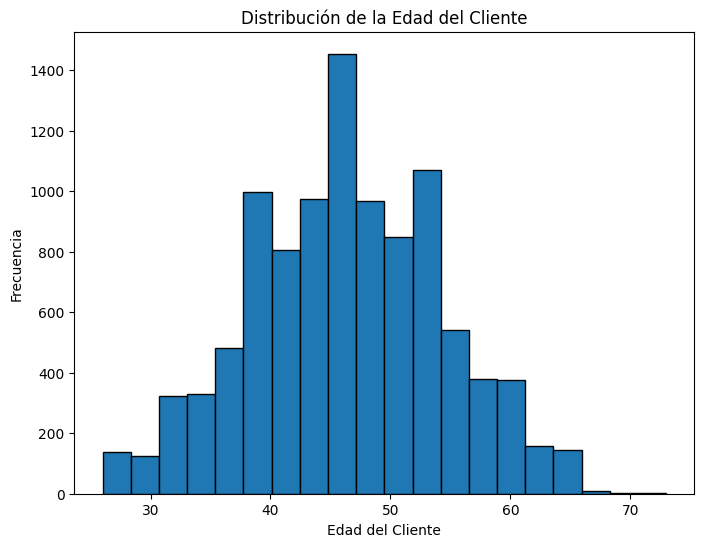

In [ ]:
# Visualización de la distribución de las edades de los clientes

plt.figure(figsize=(8, 6))
plt.hist(df['Customer_Age'], bins=20, edgecolor='black')
plt.xlabel('Edad del Cliente')
plt.ylabel('Frecuencia')
plt.title('Distribución de la Edad del Cliente')
plt.show()

In [ ]:
# Establecemos el promedio de límite de crédito según la edad de los clientes para poder graficarla

credit_limit_by_age = df.groupby('Customer_Age')['Credit_Limit'].mean().reset_index()

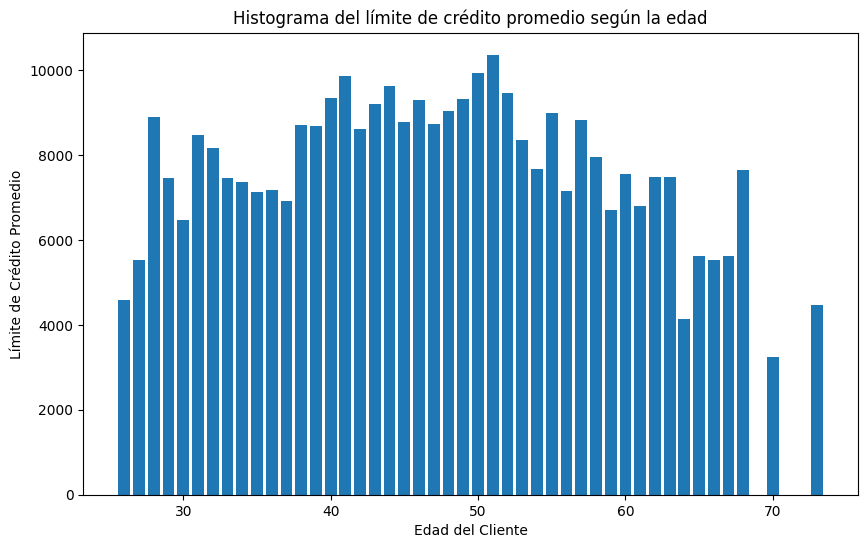

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(credit_limit_by_age['Customer_Age'], credit_limit_by_age['Credit_Limit'])
plt.xlabel('Edad del Cliente')
plt.ylabel('Límite de Crédito Promedio')
plt.title('Histograma del límite de crédito promedio según la edad')
plt.show()

In [ ]:
# Establecemos 3 rangos de edad para agrupar los datos y buscar un comportamiento más simplificado

def age_group(age):
  if age <= 35:
    return '0-35'
  elif age <= 60:
    return '35-60'
  else:
    return '60+'

# Aplicar la función a la columna 'Customer_Age' para crear la nueva columna 'Age_Group'
df['Age_Group'] = df['Customer_Age'].apply(age_group)

In [ ]:
credit_limit_by_age_group = df.groupby('Age_Group')['Credit_Limit'].mean().reset_index()

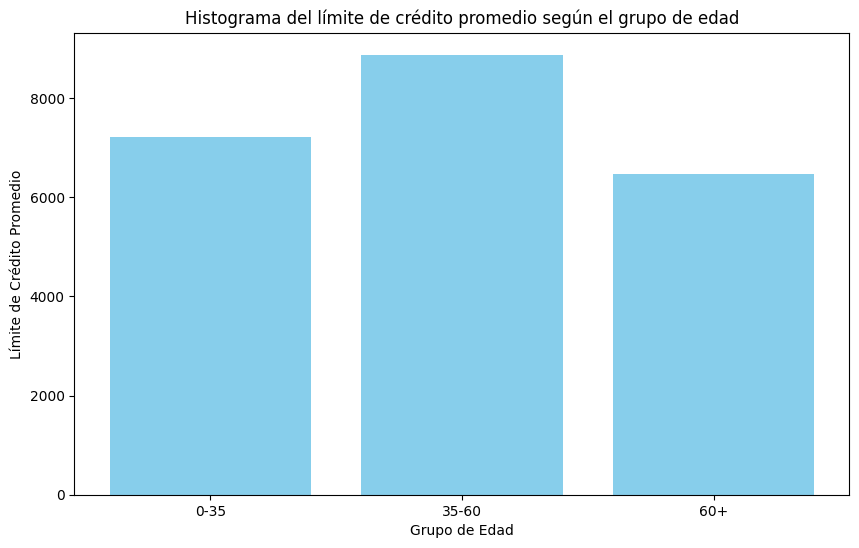

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(credit_limit_by_age_group['Age_Group'], credit_limit_by_age_group['Credit_Limit'], color='skyblue')
plt.xlabel('Grupo de Edad')
plt.ylabel('Límite de Crédito Promedio')
plt.title('Histograma del límite de crédito promedio según el grupo de edad')
plt.show()

**Conclusión de ambos Histogramas:**

Se observa una distribución parecida a una normal; identificando los límites de crédito mayores en el rango de edad de 35 a 60 años. A su vez, luego del máximo, se observa una baja de los límites incluso hasta alcanzando valores menores que a temprana edad.

In [ ]:
import seaborn as sns

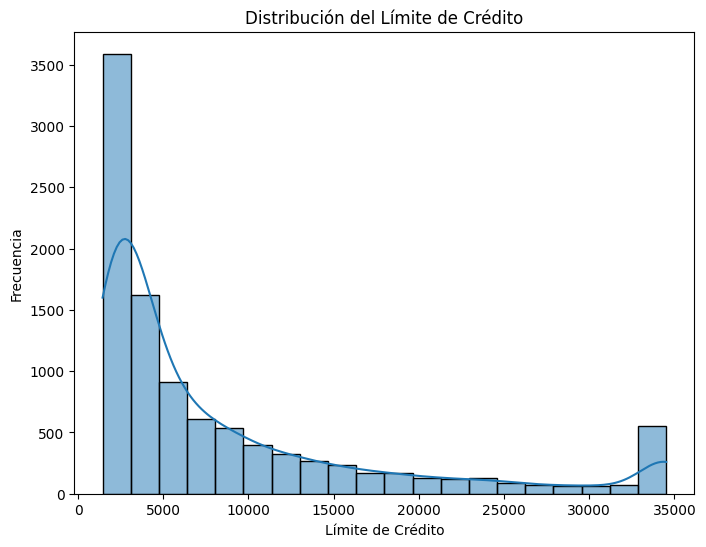

In [ ]:
# Visualición de la distribución de los límites de crédito entre los clientes

plt.figure(figsize=(8, 6))
sns.histplot(df['Credit_Limit'], bins=20, kde=True)
plt.xlabel('Límite de Crédito')
plt.ylabel('Frecuencia')
plt.title('Distribución del Límite de Crédito')
plt.show()

**Conclusión Gráfico:**

Observamos una distribución con sesgo positivo, la mayoría de las observaciones se concentran en los límite de crédito inferior.

In [ ]:
import plotly.express as px

In [ ]:
# Visualización de cantidad de clientes según cada categoría de tarjeta

colores_personalizados = {
    'Blue': 'blue',
    'Silver': 'violet',
    'Gold': 'yellow',
    'Platinum': 'grey'
}

fig = px.pie(df, names='Card_Category', values='CLIENTNUM', hole=0.4,
             color='Card_Category',
             color_discrete_map=colores_personalizados,
             title='Cantidad de clientes segun tipos de tarjetas')

fig.show()

**Conclusión Gráfico:**

El gráfico evidencia que la mayoría de los clientes tienen tarjeta con categoría Blue.
Sólo una ínfima parte de los clientes acceden a una tarjeta Platinum.

In [ ]:
# Límite de crédito promedio según categoría de tarjeta

credit_limit_by_card_category = df.groupby('Card_Category')['Credit_Limit'].mean().reset_index()

In [ ]:
order = ['Blue', 'Silver', 'Gold', 'Platinum'] #Ordenado de datos por categoría
credit_limit_by_card_category = credit_limit_by_card_category.set_index('Card_Category').loc[order].reset_index()

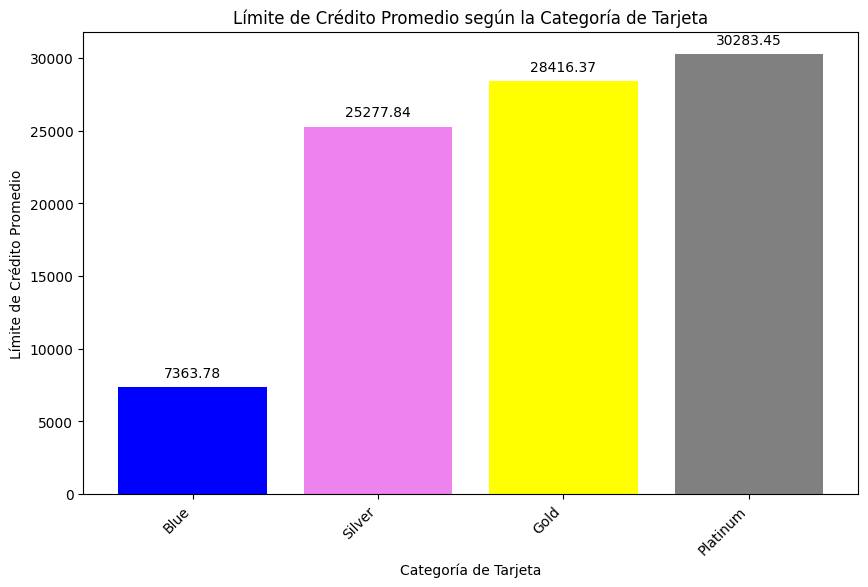

In [ ]:
# Creamos gráfico de barras con colores personalizados siguiendo parametros de grafico de dona

color_mapping = {
    'Blue': 'blue',
    'Silver': 'violet',
    'Gold': 'yellow',
    'Platinum': 'grey'
}
plt.figure(figsize=(10, 6))

bars = plt.bar(credit_limit_by_card_category['Card_Category'],
               credit_limit_by_card_category['Credit_Limit'],
               color=[color_mapping[category] for category in credit_limit_by_card_category['Card_Category']])
plt.xlabel('Categoría de Tarjeta')
plt.ylabel('Límite de Crédito Promedio')
plt.title('Límite de Crédito Promedio según la Categoría de Tarjeta')
plt.xticks(rotation=45, ha='right')

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 500, round(yval, 2), ha='center', va='bottom')
plt.show()

**Conclusión Gráfico:**

Cada tarjeta parecería tener un límite mínimo requerido. A mayor límite se accede a una mejor categoría de tarjeta.

In [ ]:
import seaborn as sns

In [ ]:
# Definición de diccionario de colores personalizados para las categorías
colores_dict = {'Blue': 'blue', 'Silver': 'violet', 'Gold': 'yellow', 'Platinum': 'grey'}

# Orden deseado de las categorías
order = ['Blue', 'Silver', 'Gold', 'Platinum']

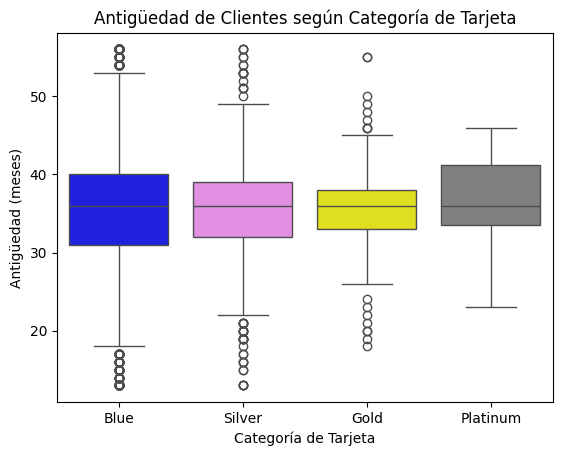

In [ ]:
sns.boxplot(x='Card_Category', y='Months_on_book', data=df, hue='Card_Category',
            palette=colores_dict, legend=False, order=order)
plt.xlabel('Categoría de Tarjeta')
plt.ylabel('Antigüedad (meses)')
plt.title('Antigüedad de Clientes según Categoría de Tarjeta')
plt.show()

**Conclusión Gráfico:**

No encontramos una relación entre la antiguedad y el tipo de categoría de tarjeta.
Se observa que dentro de la categoría Blue, se encuentran clientes con la menor antiguedad, así como también los más antiguos.


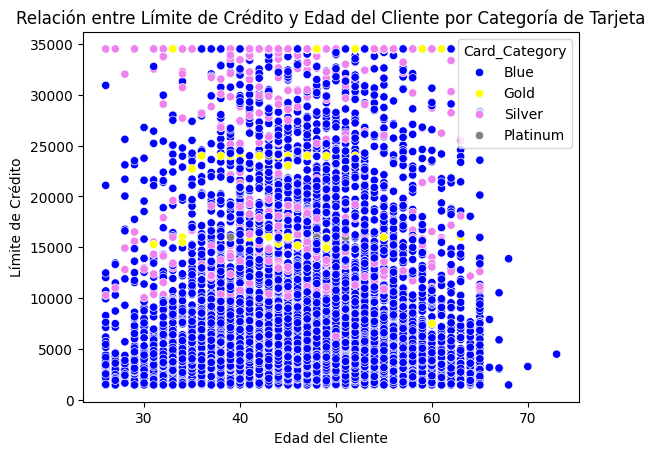

In [ ]:
# Definición de diccionario de colores personalizados para las categorías
colores_dict = {'Blue': 'blue', 'Silver': 'violet', 'Gold': 'yellow', 'Platinum': 'grey'}

# Gráfico de dispersión que vincula límite de crédito, categoría de tarjetas y edad de los clientes
sns.scatterplot(x='Customer_Age', y='Credit_Limit', hue='Card_Category', palette=colores_dict, data=df)
plt.title('Relación entre Límite de Crédito y Edad del Cliente por Categoría de Tarjeta')
plt.xlabel('Edad del Cliente')
plt.ylabel('Límite de Crédito')
plt.show()

**Conclusión Gráfico:**

Este gráfico multivariable evidencia las conclusiones obtenidad en los gráficos anteriores. La categoría de tarjetas predominante corresponde a las Blue, incluyendo todos los casos con límites de crédito inferior a 5000.

Adicionalmente, el resto de las categorías presentan límites superiores, lo que nos permite concluir que esto es un requisito para acceder a las mismas.

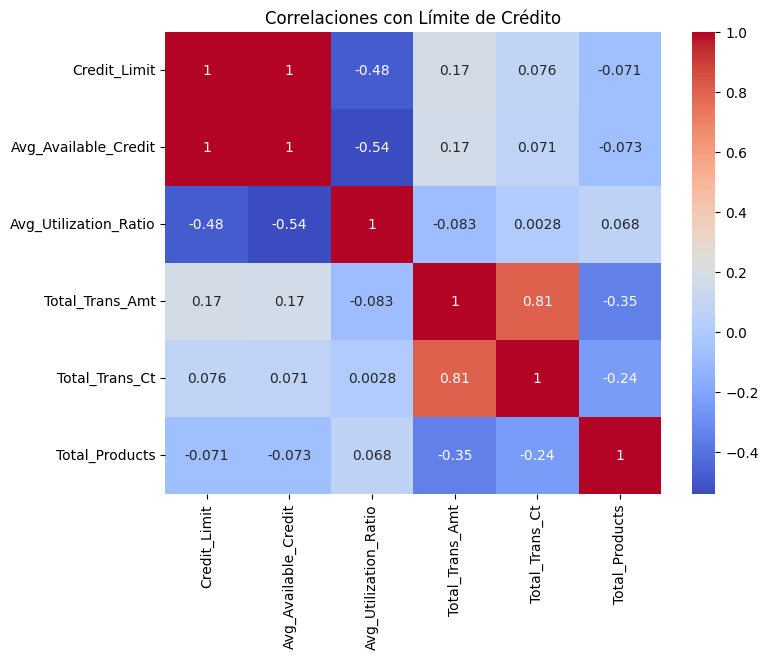

In [ ]:
# Seleccionamos únicamente variables numéricas para el análisis de correlación con límite de crédito
numeric_df = df.select_dtypes(include=['number'])

# Calculamos la matriz de correlación
correlation_matrix = numeric_df.corr()

# Obtenemos correlación con variable límite de crédito
credit_limit_correlations = correlation_matrix['Credit_Limit'].drop('Credit_Limit')

# Inlcuimos correlaciones en valor absoluto a efectos de incluir correlaciones positivas y negativas
top_5_correlations = credit_limit_correlations.abs().sort_values(ascending=False).head(5)

# Crear un heatmap de las correlaciones
plt.figure(figsize=(8, 6))
sns.heatmap(df[['Credit_Limit'] + top_5_correlations.index.tolist()].corr(), annot=True, cmap='coolwarm')
plt.title('Correlaciones con Límite de Crédito')
plt.show()

**Conclusión Gráfico:**

Visualizamos una correlación positiva perfecta con la variable *Avg_Open_To_Buy* la cual representa el disponible promedio. Esto significa que cuando se tiene una variación en una de las variables, la otra experimenta una variación en la misma proporción y signo. Ejemplo de interpretación: si un cliente aumenta su límite de crédito en un 5%, su disponible promedio aumentará también en un 5%.

Las correlaciones positivas implican que las variables experimentan cambios en el mismo signo (por ejemplo, si una variable aumenta, la otra también lo hará). Por el contrario, las correlaciones negativas implican variaciones en signo opuestos (por ejemplo, si una variable aumenta la otra sufrirá una disminución). Por otra parte, si una correlación es cero, implica que ambas variables son independientes. Ninguna variacion en alguna de las variables tiene efecto sobre la otra.


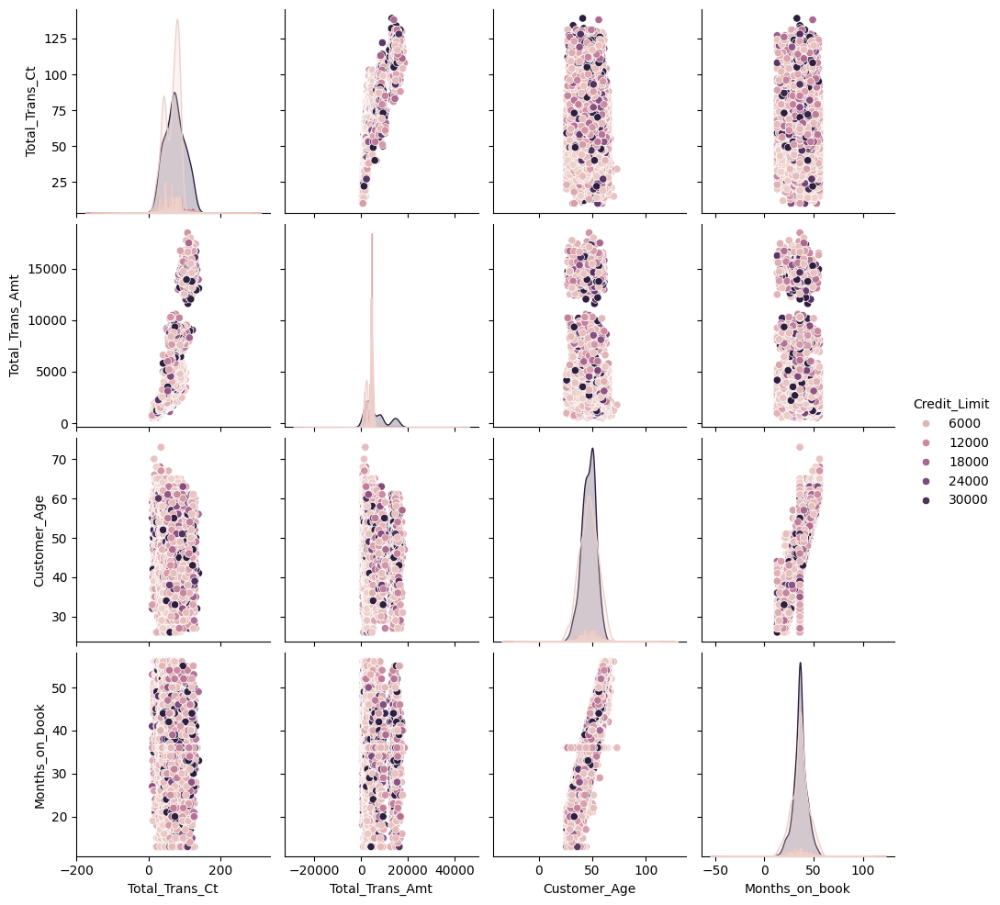

In [ ]:
#Pairplot

variables = ['Credit_Limit', 'Total_Trans_Ct', 'Total_Trans_Amt', 'Customer_Age', 'Months_on_book']
sns.pairplot(df[variables], hue='Credit_Limit')
plt.show()

#### **Conclusiones finales**

Durante el análisis pudimos determinar que las categorías de tarjetas cumplen
con la condición de que a mayor límite, mejor categoría.
La categoría principal de los clientes del dataset es la Blue, que representa el 93,2% de los casos. Esto se podría considerar como una limitación en nuestro análisis, ya que la muestra está muy sesgada en esta categoría de tarjeta.


La población de nuestro dataset se distribuye entre los 26 y 73 años, observandóse picos de límite de crédito y consumos en el entorno de los 50 años. Nuestra hipótesis vinculada a estas variables, donde planteábamos la posibilidad de que a mayor edad, mayor límite; queda descartada.


Otra de las hipótesis pensadas, indicaba que ante una mayor antiguedad, un cliente tendría una mejor categoría de tarjeta. Este escenario no se cumple. Se evidenció que la categoría Blue abarca desde los clientes más nuevos hasta los más viejos. De todas formas, es importante mencionar que el rango de antiguedad que determina nuestro dataset, va desde los 13 a los 56 meses únicamente.

**Ideas para investigaciones o análisis futuros basados en lo
observado:**
Podría ser interesante comprender por qué los clientes que cuentan con límites superiores, no han accedido a tarjetas premium. Por ejemplo, existen unos 727 clientes con ingresos superiores a $120K, mientras que únicamente se cuenta con 20 tarjetas Platinum. Con la información obtenida, cabría la posibilidad de recategorizar clientes y/o redefinir los productos.


#### **Anexo: Data Profiling**

In [ ]:
!pip install ydata-profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.9/390.9 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 9.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 19.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 14.0 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=ac5b85a54c662733a20be48efa2608a35e7e6b6746e35053d0e38b5ed8a6e263
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
from ydata_profiling import ProfileReport

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Trabajo final/BankChurners.csv', encoding='latin-1')

In [ ]:
profile = ProfileReport(df, title='Informe de tarjetas de crédito', explorative=False)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]